In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# **Dataset**
** [**DOTA**](https://captain-whu.github.io/DOTA/index.html)**
---

DOTA is a large-scale dataset for object detection in aerial images. It can be used to develop and evaluate object detectors in aerial images. The images are collected from different sensors and platforms. Each image is of the size in the range from 800 × 800 to 20,000 × 20,000 pixels and contains objects exhibiting a wide variety of scales, orientations, and shapes. The instances in DOTA images are annotated by experts in aerial image interpretation by arbitrary (8 d.o.f.) quadrilateral.

DOTA-v1.0 contains 15 common categories, 2,806 images and 188, 282 instances. The proportions of the training set, validation set, and testing set in DOTA-v1.0 are 1/2, 1/6, and 1/3, respectively.


The object categories in DOTA-v1.0: **plane, ship, storage tank, baseball diamond, tennis court, basketball court, ground track field, harbor, bridge, large vehicle, small vehicle, helicopter, roundabout, soccer ball field and swimming pool**


> Annotation format :
> x1, y1, x2, y2, x3, y3, x4, y4, category, difficult

# DOTA_600 : Smaller Version Of Dota with 600 Images
Dota v1 contain


1.   Train Data : 1411
2.   Test Data  : 937
3.   validation Data : 458

In DOTA_600:
1.   Train Data : 300
2.   Test Data  : 200
3.   validation Data : 100



> These images are chosen Randomly by this images.py scrript.


```
import os
import random
import shutil

def select_random_images(src_img_dir, dst_img_dir, src_anno_dir, dst_anno_dir, num_images):
    # Get a list of all image files in the source image directory
    all_images = [f for f in os.listdir(src_img_dir) if os.path.isfile(os.path.join(src_img_dir, f))]
    
    # Randomly select the specified number of images
    selected_images = random.sample(all_images, num_images)
    
    # Ensure the destination directories exist for images and annotations
    os.makedirs(dst_img_dir, exist_ok=True)
    os.makedirs(dst_anno_dir, exist_ok=True)
    
    for image in selected_images:
        # Copy image file
        src_image_path = os.path.join(src_img_dir, image)
        dst_image_path = os.path.join(dst_img_dir, image)
        shutil.copy(src_image_path, dst_image_path)
        print(f'Copied {image} to {dst_image_path}')
        
        # Construct annotation file path (replace .png with .txt)
        annotation_file = image.replace('.png', '.txt')
        src_annotation_path = os.path.join(src_anno_dir, annotation_file)
        dst_annotation_path = os.path.join(dst_anno_dir, annotation_file)
        
        if os.path.exists(src_annotation_path):
            shutil.copy(src_annotation_path, dst_annotation_path)
            print(f'Copied {annotation_file} to {dst_annotation_path}')
        else:
            print(f'No annotation file found for {image}')

# Example usage for training set
src_img_dir = r'D:\dota\train\image'    # Source directory path for training images
dst_img_dir = r'D:\dota_600\train\image'  # Destination directory path for training images
src_anno_dir = r'D:\dota\train\annotations'  # Source directory path for training annotations
dst_anno_dir = r'D:\dota_600\train\annotations'  # Destination directory path for training annotations
number_of_images = 300  # Number of images you want to select for training

select_random_images(src_img_dir, dst_img_dir, src_anno_dir, dst_anno_dir, number_of_images)

# Example usage for test set
src_img_dir = r'D:\dota\test\image'    # Source directory path for test images
dst_img_dir = r'D:\dota_600\test\image'  # Destination directory path for test images
number_of_images = 200  # Number of images you want to select for testing

select_random_images(src_img_dir, dst_img_dir, src_anno_dir, dst_anno_dir, number_of_images)

# Example usage for validation set
src_img_dir = r'D:\dota\val\image'    # Source directory path for validation images
dst_img_dir = r'D:\dota_600\val\image'  # Destination directory path for validation images
src_anno_dir = r'D:\dota\val\annotations'  # Source directory path for training annotations
dst_anno_dir = r'D:\dota_600\val\annotations'  # Destination directory path for training annotations
number_of_images = 100  # Number of images you want to select for validation

select_random_images(src_img_dir, dst_img_dir, src_anno_dir, dst_anno_dir, number_of_images)

```









In [ ]:
dataset_path = '/content/drive/MyDrive/Colab Notebooks/dota_600'

# **Library**

In [ ]:
import numpy as np
import os
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import json
from pycocotools.coco import COCO
import random
import torch
from torch.utils.data import Dataset, DataLoader
from albumentations.pytorch import ToTensorV2
import albumentations as A

# **Path of The Images**

In [ ]:
train_images_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train/images'
test_images_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/test/images'
val_images_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val/images'

# **Display Sample Images**

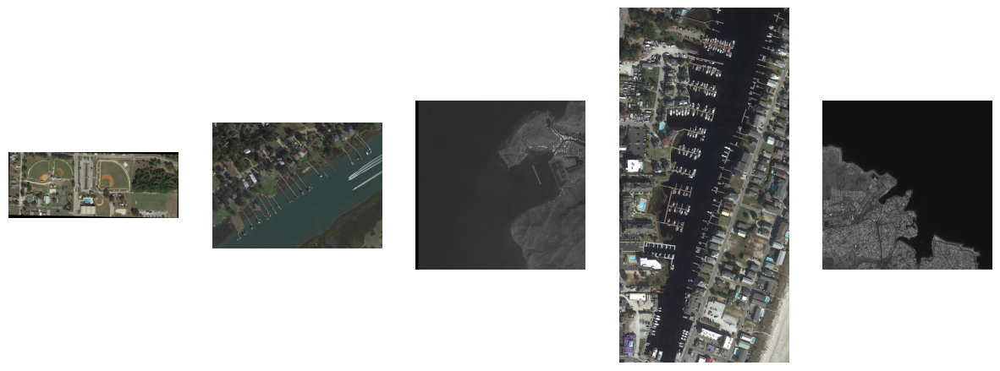

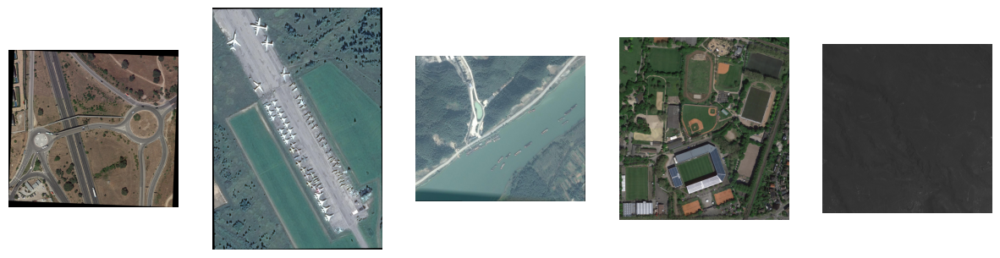

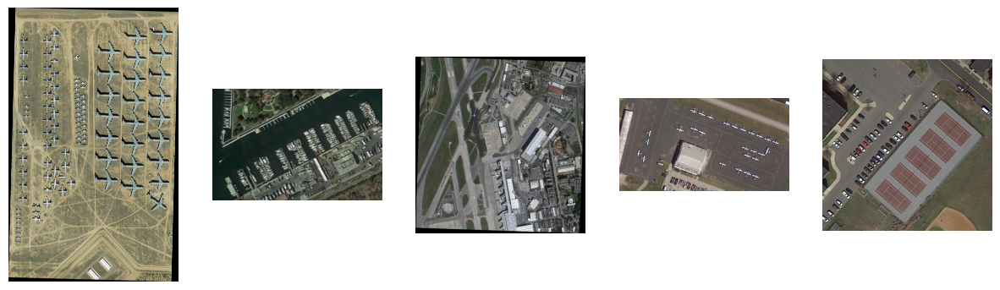

In [ ]:
def load_and_display_sample_images(dataset_path, num_images=5):
    sample_images = []
    image_filenames = os.listdir(dataset_path)[:num_images]  # Get first `num_images` filenames

    for filename in image_filenames:
        if filename.endswith('.png'):  # Ensure the file is a .png image
            img_path = os.path.join(dataset_path, filename)
            img = cv2.imread(img_path)  # Load image using OpenCV

            if img is None:
                print(f"Failed to load image: {img_path}")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB
            sample_images.append(img)
            #print(f"Loaded image: {img_path}")
        else:
             print(f"Skipping non-png file: {filename}")

    return sample_images

# Load and display sample images from the dataset
sample_images_train = load_and_display_sample_images(train_images_path)
sample_images_test = load_and_display_sample_images(test_images_path)
sample_images_val = load_and_display_sample_images(val_images_path)

# Display the sample images
if sample_images_train:
    plt.figure(figsize=(15, 8))
    for i, image in enumerate(sample_images_train):
        plt.subplot(1, len(sample_images_train), i + 1)
        plt.imshow(image)
        plt.axis('off')
    plt.show()
else:
    print("No images to display.")
    # Display the sample images
if sample_images_test:
    plt.figure(figsize=(15, 8))
    for i, image in enumerate(sample_images_test):
        plt.subplot(1, len(sample_images_test), i + 1)
        plt.imshow(image)
        plt.axis('off')
    plt.show()
else:
    print("No images to display.")
    # Display the sample images
if sample_images_val:
    plt.figure(figsize=(15, 8))
    for i, image in enumerate(sample_images_val):
        plt.subplot(1, len(sample_images_val), i + 1)
        plt.imshow(image)
        plt.axis('off')
    plt.show()
else:
    print("No images to display.")

# **The COCO (Common Objects in Context) format**

It is a standard format for storing and sharing annotations for images and videos. It is JSON FIle.


> JSON Structure

Image
>
    "id": int,
    "width": int,
    "height": int,
    "file_name": str
Category
>
    "id": int,
    "name": str,
    "supercategory": str

In [ ]:
def convert_dota_to_coco(dota_path, coco_output_path):
    categories = [
        {'id': 1, 'name': 'plane'},
        {'id': 2, 'name': 'baseball'},
        {'id': 3, 'name': 'bridge'},
        {'id': 4, 'name': 'ground-track-field'},
        {'id': 5, 'name': 'small-vehicle'},
        {'id': 6, 'name': 'large-vehicle'},
        {'id': 7, 'name': 'ship'},
        {'id': 8, 'name': 'tennis-court'},
        {'id': 9, 'name': 'basketball-court'},
        {'id': 10, 'name': 'storage-tank'},
        {'id': 11, 'name': 'soccer-ball-field'},
        {'id': 12, 'name': 'roundabout'},
        {'id': 13, 'name': 'harbor'},
        {'id': 14, 'name': 'swimming-pool'},
        {'id': 15, 'name': 'helicopter'}
    ]

    images = []
    annotations = []
    ann_id = 1

    image_dir = os.path.join(dota_path, 'images')
    annotation_dir = os.path.join(dota_path, 'annotations')

    for img_id, img_file in enumerate(os.listdir(image_dir)):
        if img_file.endswith('.png'):
            img_path = os.path.join(image_dir, img_file)
            img = cv2.imread(img_path)
            h, w, _ = img.shape

            images.append({
                'id': img_id,
                'file_name': img_file,
                'height': h,
                'width': w
            })

            ann_file = os.path.join(annotation_dir, img_file.replace('.png', '.txt'))
            with open(ann_file, 'r') as f:
                for line in f:
                    parts = line.strip().split(' ')
                    if len(parts) != 10:
                        continue  # Skip lines that do not contain the expected number of parts
                    bbox = list(map(float, parts[:8]))
                    class_name = parts[8]

                    category_id = next((cat['id'] for cat in categories if cat['name'] == class_name), None)
                    if category_id is None:
                        continue

                    x = [bbox[i] for i in range(0, 8, 2)]
                    y = [bbox[i] for i in range(1, 8, 2)]
                    x_min, y_min = min(x), min(y)
                    x_max, y_max = max(x), max(y)
                    width = x_max - x_min
                    height = y_max - y_min

                    annotations.append({
                        'id': ann_id,
                        'image_id': img_id,
                        'category_id': category_id,
                        'bbox': [x_min, y_min, width, height],
                        'area': width * height,
                        'iscrowd': 0
                    })
                    ann_id += 1

    coco_data = {
        'images': images,
        'annotations': annotations,
        'categories': categories
    }

    # Ensure the output directory exists
    os.makedirs(os.path.dirname(coco_output_path), exist_ok=True)

    with open(coco_output_path, 'w') as f:
        json.dump(coco_data, f, indent=4)

In [ ]:
train_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train'  # Path to your DOTA dataset
val_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val'  # Path to your DOTA dataset
coco_output_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train_coco_annotations.json'  # Output path for COCO JSON
coco_val_output_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val_coco_annotations.json'  # Output path for COCO JSON

# convert_dota_to_coco(train_path, coco_output_path)  #train JSON File
# convert_dota_to_coco(val_path, coco_val_output_path) #validation JSON FILE

# **Visualization of annotations on images based on COCO format**

In [ ]:
def visualize_coco_annotations(coco_path, image_dir, num_images=5):
    # Load COCO annotations
    with open(coco_path, 'r') as f:
        coco_data = json.load(f)

    # Create a dictionary to map category IDs to names
    category_map = {category['id']: category['name'] for category in coco_data['categories']}

    # fixed colors for categories based on category IDs
    category_colors = {}
    for category_id in category_map.keys():
        random.seed(category_id)  # Use category ID for consistent color
        category_colors[category_id] = (random.random(), random.random(), random.random())

    # Display the specified number of images with annotations
    for img_info in coco_data['images'][:num_images]:
        image_path = os.path.join(image_dir, img_info['file_name'])
        img = cv2.imread(image_path)
       #img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        ax = plt.gca()

        # Get annotations for the current image
        anns = [ann for ann in coco_data['annotations'] if ann['image_id'] == img_info['id']]

        # Draw bounding boxes
        for ann in anns:
            bbox = ann['bbox']
            category_id = ann['category_id']
            category_name = category_map[category_id]

            x, y, width, height = bbox
            color = category_colors[category_id]
            rect = Rectangle((x, y), width, height, linewidth=2, edgecolor= color, facecolor='none')
            ax.add_patch(rect)
            plt.text(x, y, category_name, color=color, fontsize=12, bbox=dict(facecolor='none', alpha=0.5))

        plt.axis('off')
        plt.show()

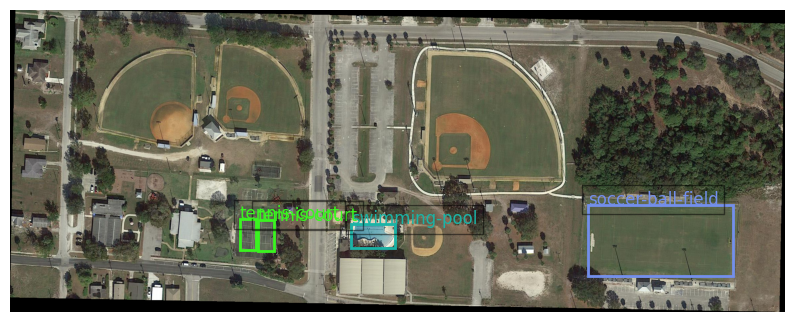

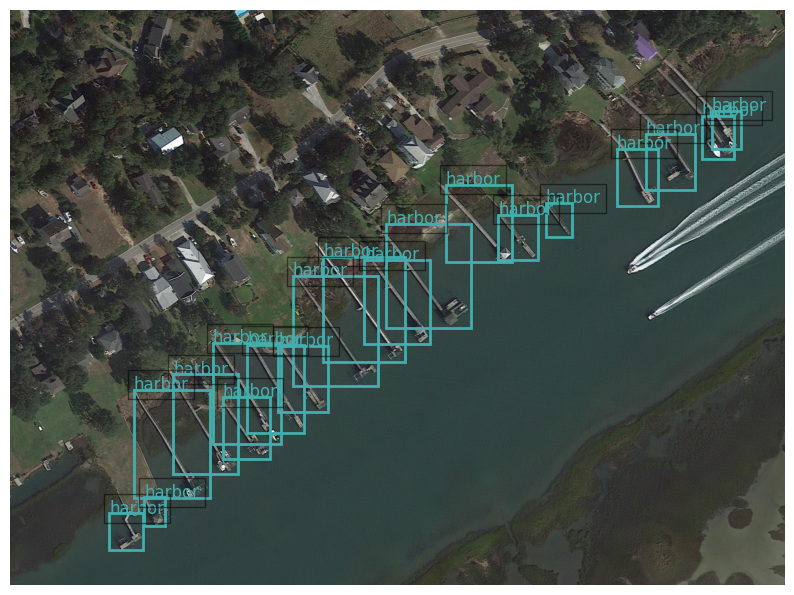

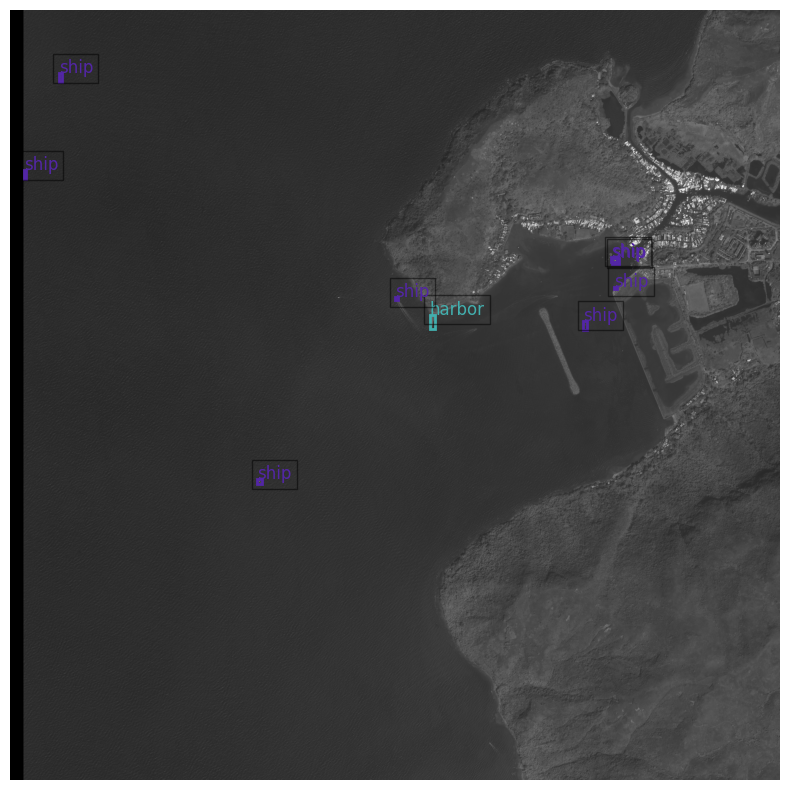

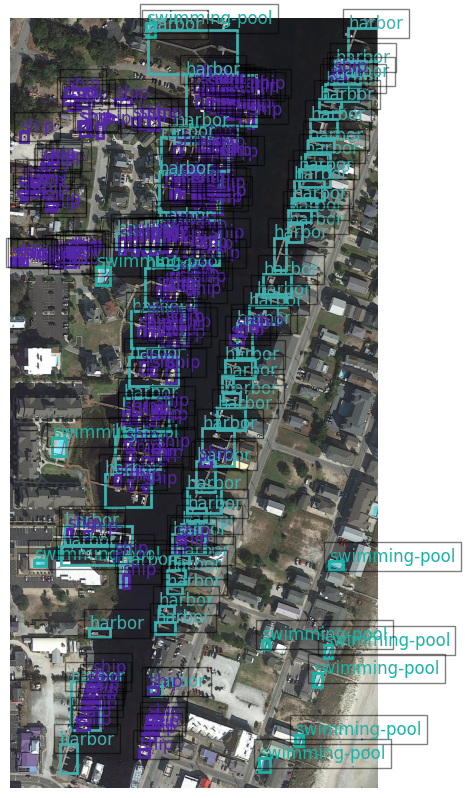

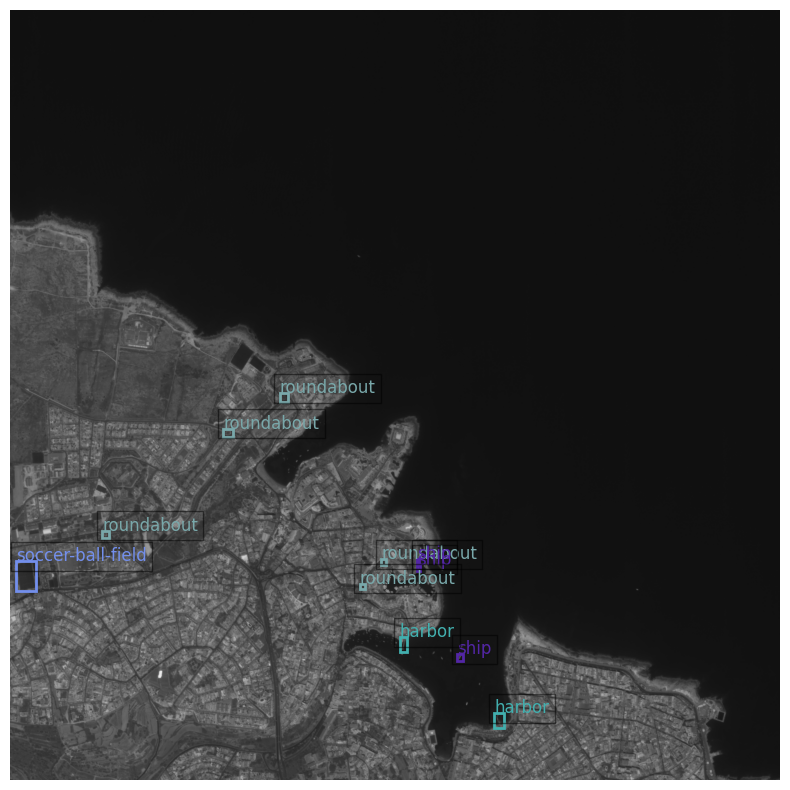

...

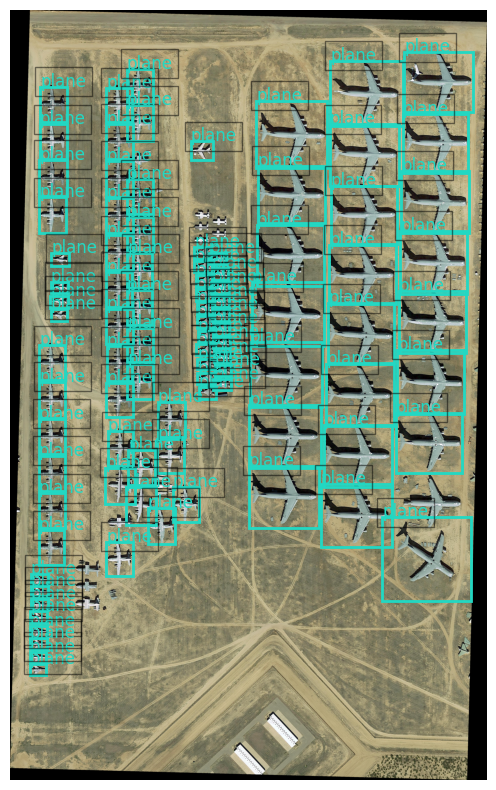

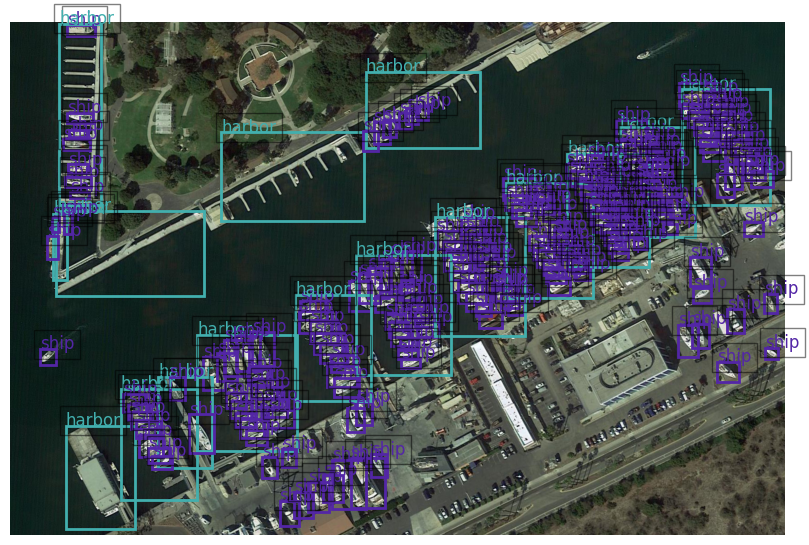

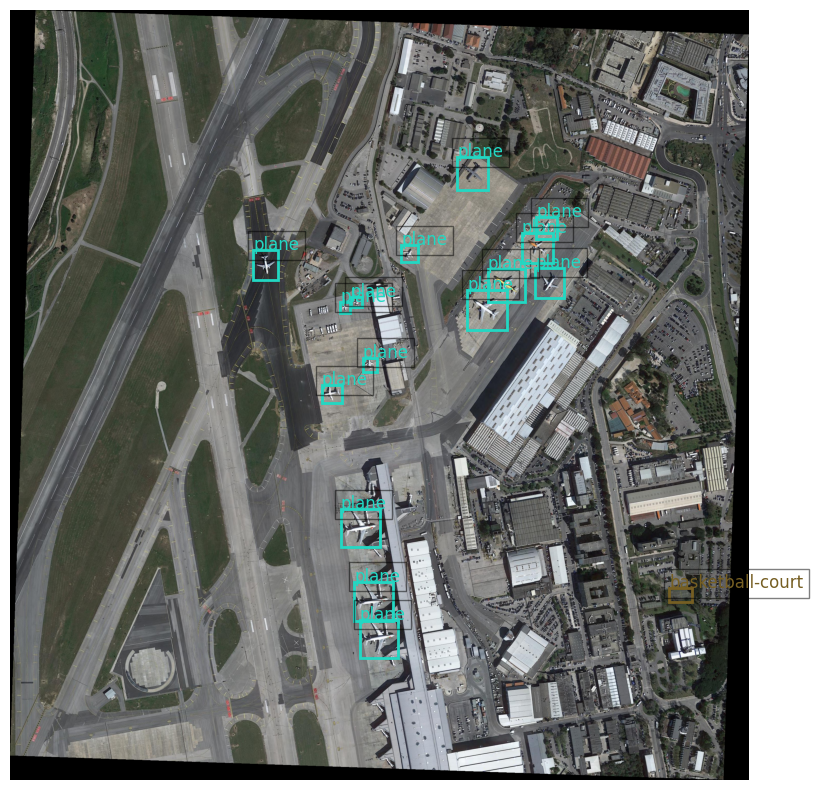

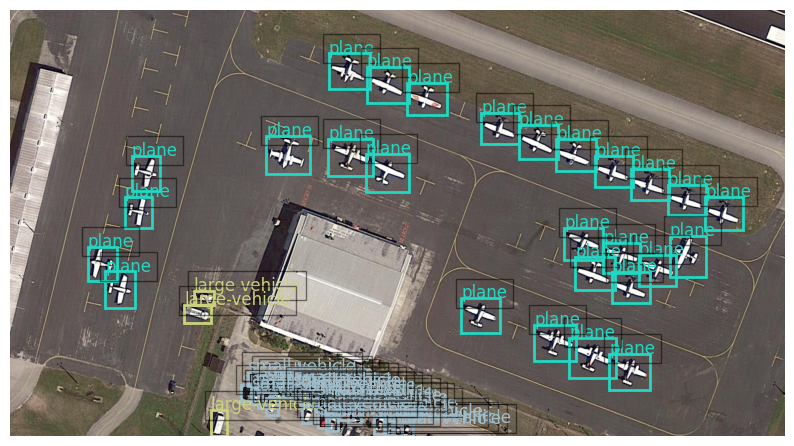

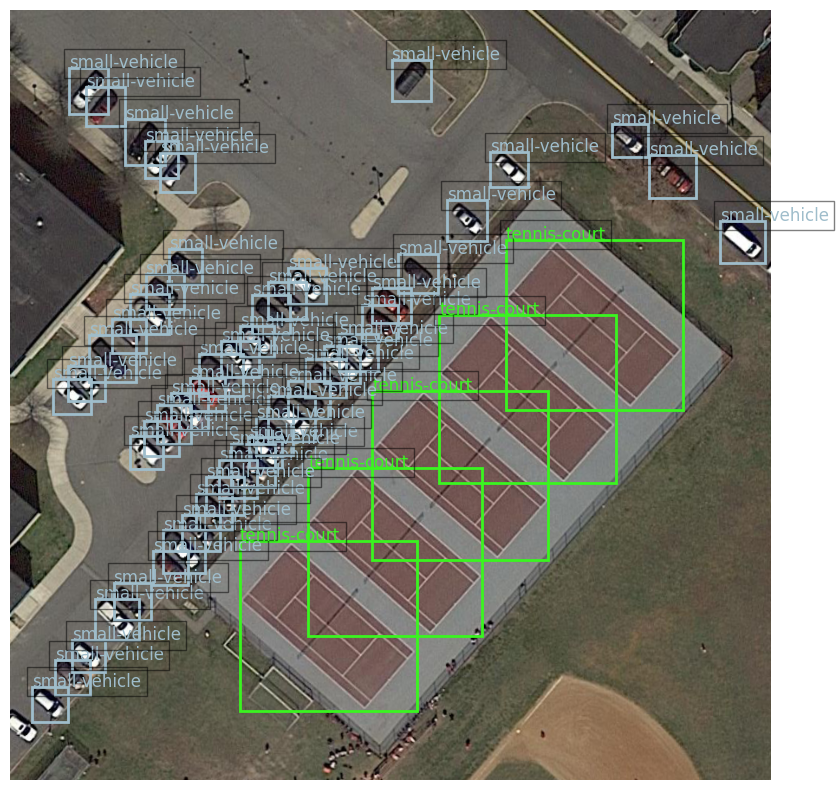

In [ ]:
# Example usage
coco_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train_coco_annotations.json'  # Path to your COCO annotations file
coco_val_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val_coco_annotations.json'  # Path to your COCO annotations file

visualize_coco_annotations(coco_path, train_images_path, num_images=10)
visualize_coco_annotations(coco_val_path, val_images_path, num_images=5)

# Data Augmentation
# Custom dataset
> A custom dataset refers to a specialized dataset that is tailored to the specific requirements of a particular machine learning or deep learning task. These datasets are created and organized in a way that suits the unique characteristics of the problem at hand, often involving specific data formats, annotations, or preprocessing steps that are not covered by standard, pre-existing datasets.






loading annotations into memory...
Done (t=0.25s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!


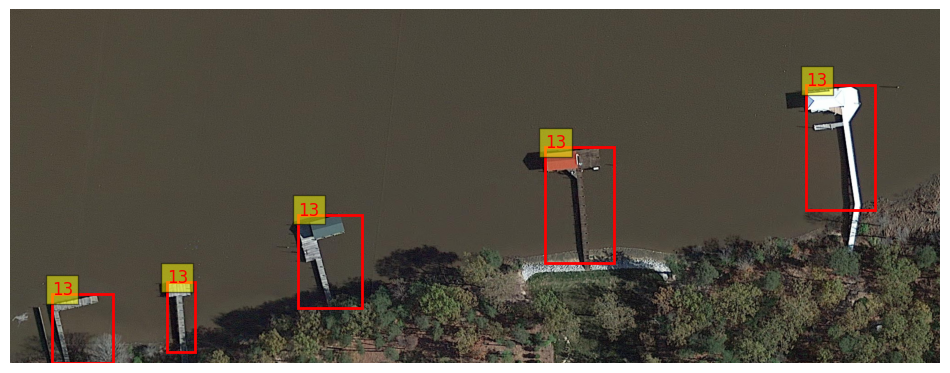

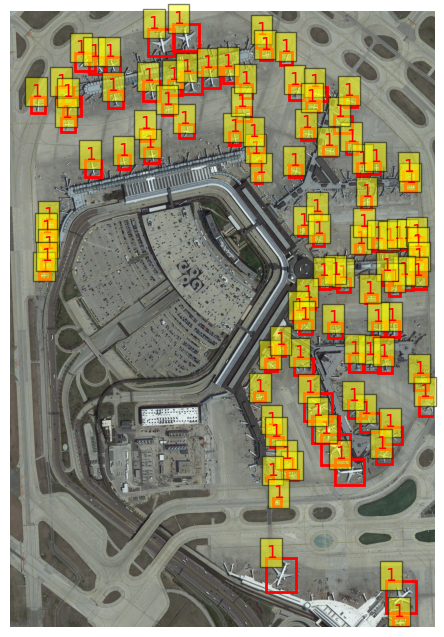

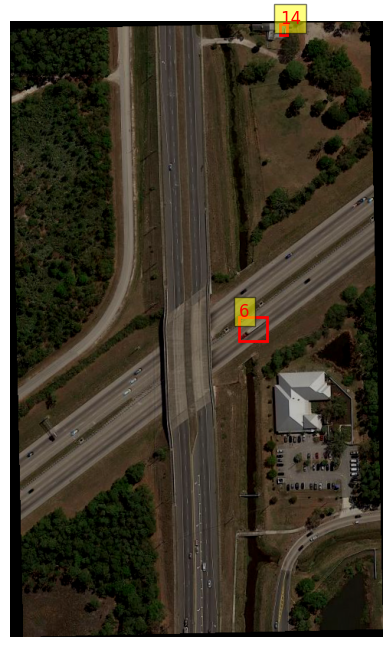

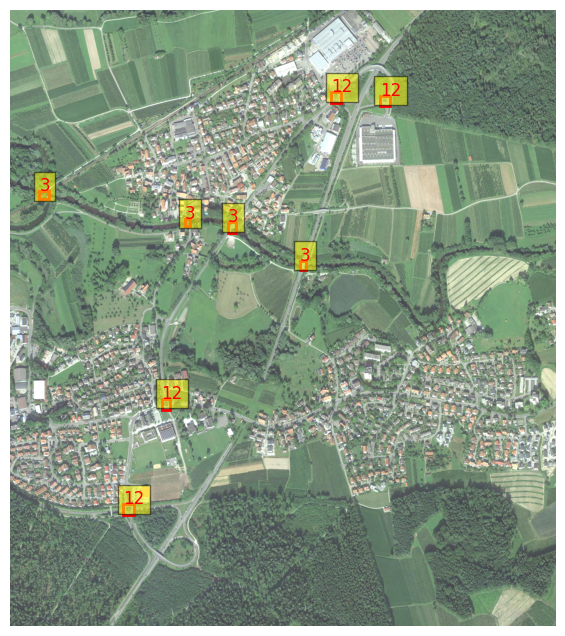

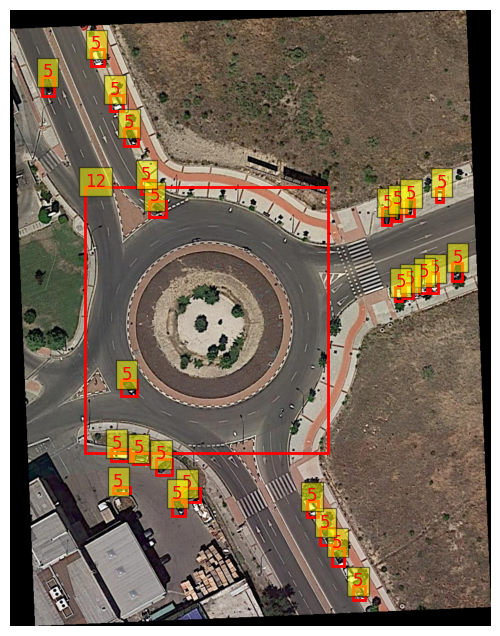

...

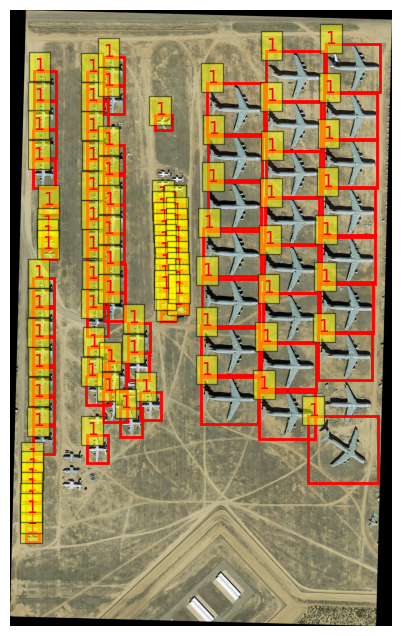

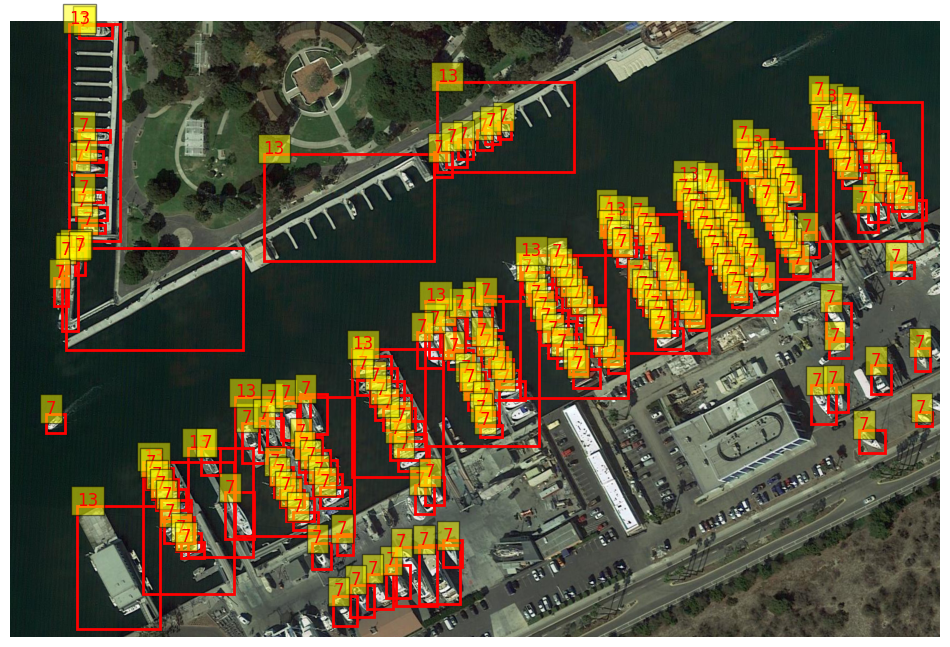

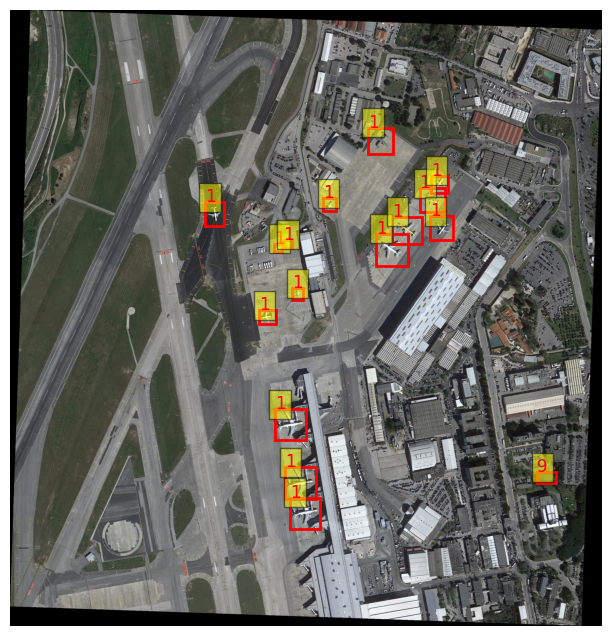

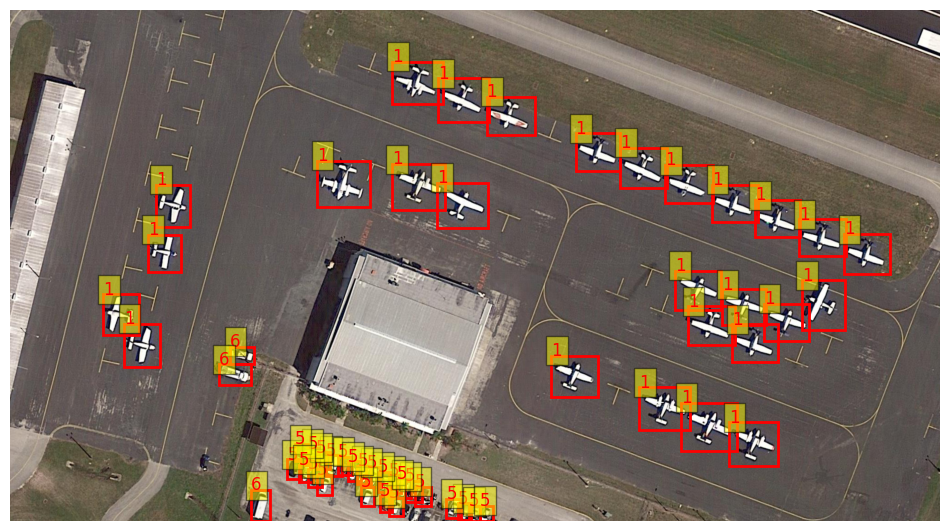

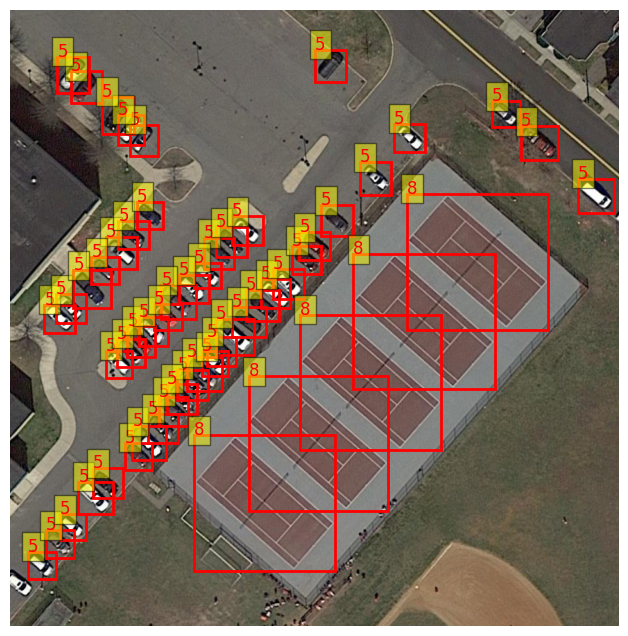

In [ ]:
# Define augmentation pipeline
def get_train_transforms():
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)), #normilized with stattistical value(IMAGENET)
        ToTensorV2() #convert to tensor(numpy array)
    ], bbox_params=A.BboxParams(format='coco', label_fields=['labels']))

def get_valid_transforms():
    return A.Compose([
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)), #normilized with stattistical value(IMAGENET)
        ToTensorV2() #convert to tensor(numpy array)
    ], bbox_params=A.BboxParams(format='coco', label_fields=['labels']))


class COCODataset(Dataset):
    def __init__(self, coco, image_dir, transforms=None):
        self.coco = coco                   # COCO instance containing annotations
        self.image_dir = image_dir         # Directory containing images
        self.transforms = transforms       # Transformations to apply to the images
        self.image_ids = self.coco.getImgIds()  # Get list of image IDs in COCO dataset

    def __len__(self):
        return len(self.image_ids)         # Return the total number of images in the dataset

    def __getitem__(self, idx):
        # Get the image ID at the given index
        image_id = self.image_ids[idx]
        image_info = self.coco.loadImgs(image_id)[0]  # Load image information using COCO API
        image_path = os.path.join(self.image_dir, image_info['file_name'])  # Construct image path

        # Read image using OpenCV
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert image to RGB format

        # Get annotation IDs associated with the current image ID
        ann_ids = self.coco.getAnnIds(imgIds=image_id)
        anns = self.coco.loadAnns(ann_ids)

        # Extract bounding boxes and category IDs from annotations
        bboxes = []
        labels = []
        for ann in anns:
            bbox = ann['bbox']
            x, y, width, height = bbox
            # Check for valid width and height (positive values only)
            if width > 0 and height > 0:
                bboxes.append([x, y, width, height])  # Keep the bounding box
                labels.append(ann['category_id'])     # Keep the label

        # Apply transformations to the image and annotations (if any)
        if self.transforms:
            transformed = self.transforms(image=image, bboxes=bboxes, labels=labels)
            image = transformed['image']
            bboxes = transformed['bboxes']
            labels = transformed['labels']

        # Prepare the target dictionary
        target = {
            'boxes': torch.tensor(bboxes, dtype=torch.float32),
            'labels': torch.tensor(labels, dtype=torch.int64)
        }

        # Return the image and target
        return image, target

# Paths to COCO annotations and images
train_coco_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train_coco_annotations.json'
train_image_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/train/images'
val_coco_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val_coco_annotations.json'
val_image_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/val/images'

# Load COCO datasets
coco_train = COCO(train_coco_path)
coco_val = COCO(val_coco_path)

# Create dataset instances
train_dataset = COCODataset(coco_train, train_image_dir, transforms=get_train_transforms())
val_dataset = COCODataset(coco_val, val_image_dir, transforms=get_valid_transforms())
def collate_fn(batch):
    images = [item[0] for item in batch]
    targets = []

    for i, item in enumerate(batch):
        if len(item[1]) == 0:
            # If no annotations are available, skip
            continue

        # Ensure each annotation has 4 elements
        boxes = torch.tensor([ann['bbox'] for ann in item[1]], dtype=torch.float32)

        if boxes.dim() == 1:
            # If there's only one annotation, reshape it to 2D (1, 4)
            boxes = boxes.unsqueeze(0)

        if boxes.size(1) == 4:
            # Convert COCO format (x, y, width, height) to (x_min, y_min, x_max, y_max)
            boxes[:, 2:] += boxes[:, :2]  # Modify in place

        labels = torch.tensor([ann['category_id'] for ann in item[1]], dtype=torch.int64)

        # Create a dictionary with 'boxes' and 'labels'
        targets.append({
            'boxes': boxes,
            'labels': labels,
            'image_id': torch.tensor([i])  # Example: Adding image_id for reference
        })

    return images, targets
# Create data loaders(DataLoader is a PyTorch utility that helps in efficiently loading and batching data during training or evaluation.)
train_loader = DataLoader(train_dataset, batch_size=6, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=5, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Iterate through the training data loader and visualize a few samples
def visualize_sample(image, target):
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    image = image.permute(1, 2, 0).numpy()
    image = image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]) #Reverse Normilization
    image = np.clip(image, 0, 1)
    ax.imshow(image)

    for box, label in zip(target['boxes'], target['labels']):
        x, y, width, height = box
        rect = Rectangle((x, y), width, height, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        plt.text(x, y, str(label.item()), color='red', fontsize=12, bbox=dict(facecolor='yellow', alpha=0.5))

    plt.axis('off')
    plt.show()

# Visualize a few samples from the training set
for images, targets in train_loader:
    for image, target in zip(images, targets):
        visualize_sample(image, target)
    break  # Display only the first batch of images

# Visualize a few samples from the val set
for images, targets in val_loader:
    for image, target in zip(images, targets):
        visualize_sample(image, target)
    break  # Display only the first batch of images


# **YOLO  (You Only Look Once)**
 **YOLO (You Only Look Once) is a popular object detection model. You can train a YOLO model using the batches of images and annotations provided by the data loader. YOLO typically requires images and bounding box annotations (sometimes class labels) as inputs during training.**




In [ ]:
def convert_dota_to_yolo(dota_path, output_dir):
    # Create paths for images and annotations
    image_dir = os.path.join(dota_path, 'images')
    annotation_dir = os.path.join(dota_path, 'annotations')

    # Create a folder named 'labels' inside the specified output directory
    labels_output_dir = os.path.join(output_dir, 'labels')
    os.makedirs(labels_output_dir, exist_ok=True)

    # Define categories list (mapping class names to IDs)
    categories = [
        {'id': 1, 'name': 'plane'},
        {'id': 2, 'name': 'baseball-diamond'},
        {'id': 3, 'name': 'bridge'},
        {'id': 4, 'name': 'ground-track-field'},
        {'id': 5, 'name': 'small-vehicle'},
        {'id': 6, 'name': 'large-vehicle'},
        {'id': 7, 'name': 'ship'},
        {'id': 8, 'name': 'tennis-court'},
        {'id': 9, 'name': 'basketball-court'},
        {'id': 10, 'name': 'storage-tank'},
        {'id': 11, 'name': 'soccer-ball-field'},
        {'id': 12, 'name': 'roundabout'},
        {'id': 13, 'name': 'harbor'},
        {'id': 14, 'name': 'swimming-pool'},
        {'id': 15, 'name': 'helicopter'}
    ]

    # Loop over each image file in the image directory
    for img_file in os.listdir(image_dir):
        if img_file.endswith('.png'):
            img_path = os.path.join(image_dir, img_file)
            img = cv2.imread(img_path)
            if img is None:
                print(f"Error reading image: {img_file}")
                continue
            h, w, _ = img.shape  # Get image dimensions

            # Corresponding annotation file
            ann_file = os.path.join(annotation_dir, img_file.replace('.png', '.txt'))
            output_ann_file = os.path.join(labels_output_dir, img_file.replace('.png', '.txt'))

            # Read the annotation file and write it in YOLO format
            with open(ann_file, 'r') as f, open(output_ann_file, 'w') as out_f:
                for line in f:
                    parts = line.strip().split(' ')
                    if len(parts) != 10:
                        continue

                    # Extract bounding box and class name
                    bbox = list(map(float, parts[:8]))
                    class_name = parts[8]

                    # Convert polygon to YOLO format (center_x, center_y, width, height)
                    x = [bbox[i] for i in range(0, 8, 2)]
                    y = [bbox[i] for i in range(1, 8, 2)]
                    x_min, y_min = min(x), min(y)
                    x_max, y_max = max(x), max(y)
                    bbox_width = x_max - x_min
                    bbox_height = y_max - y_min
                    center_x = x_min + bbox_width / 2
                    center_y = y_min + bbox_height / 2

                    # Normalize values by image dimensions
                    center_x /= w
                    center_y /= h
                    bbox_width /= w
                    bbox_height /= h

                    # Get category ID from class name
                    category_id = next((cat['id'] for cat in categories if cat['name'] == class_name), None)

                    # If category ID found, write to output in YOLO format
                    if category_id is not None:
                        out_f.write(f"{category_id - 1} {center_x} {center_y} {bbox_width} {bbox_height}\n")
                       # print(f"Wrote annotation for {img_file}: {category_id - 1} {center_x} {center_y} {bbox_width} {bbox_height}")

In [ ]:
dota_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/train'
output_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/train'
convert_dota_to_yolo(dota_path, output_dir)

dota_val_path = '/content/drive/MyDrive/Colab Notebooks/dota_600/val'
output_val_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/val'
convert_dota_to_yolo(dota_val_path, output_val_dir)

In [ ]:
#!pip install ultralytics

In [ ]:
 #from ultralytics import YOLO

# Load a pretrained model (you can choose different models like yolov8n.pt, yolov8s.pt, etc.)
model = YOLO('yolov8n.pt')

# Train the model on your COCO-format dataset
model.train(data='/content/drive/MyDrive/Colab Notebooks/dota_600/data.yaml', epochs=10, imgsz=640, batch=16)


Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/Colab Notebooks/dota_600/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_la

train: Scanning /content/drive/MyDrive/Colab Notebooks/dota_600/train/labels.cache... 300 images, 0 backgrounds, 0 corrupt: 100%|██████████| 300/300 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/Colab Notebooks/dota_600/val/labels.cache... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<?, ?it/s]


Plotting labels to runs/detect/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000526, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train6
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      11.7G      2.324      4.795      1.422        775        640: 100%|██████████| 19/19 [01:31<00:00,  4.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.44it/s]

                   all        100       6588     0.0364     0.0153     0.0249     0.0205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      13.2G      2.214      4.082      1.231        710        640: 100%|██████████| 19/19 [01:26<00:00,  4.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.62it/s]

                   all        100       6588     0.0159     0.0838     0.0371     0.0236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      13.4G      2.122      3.216      1.158        481        640: 100%|██████████| 19/19 [01:26<00:00,  4.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.15it/s]

                   all        100       6588     0.0224      0.185       0.08     0.0484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      13.8G      2.094       2.93       1.13        461        640: 100%|██████████| 19/19 [01:28<00:00,  4.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]


                   all        100       6588      0.717     0.0965      0.115     0.0696

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      12.8G      2.083      2.696      1.119        424        640: 100%|██████████| 19/19 [01:22<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]


                   all        100       6588       0.67      0.122      0.121     0.0747

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      11.1G      1.991      2.514      1.112        573        640: 100%|██████████| 19/19 [01:26<00:00,  4.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


                   all        100       6588      0.715      0.155      0.143     0.0848

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      11.3G      2.008      2.399      1.094       1071        640: 100%|██████████| 19/19 [01:23<00:00,  4.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.12it/s]

                   all        100       6588      0.701       0.16      0.152     0.0891



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      12.1G      1.957      2.256      1.071       2093        640: 100%|██████████| 19/19 [01:35<00:00,  5.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]


                   all        100       6588      0.698      0.181      0.165     0.0965

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10        12G      1.911      2.122      1.071        269        640: 100%|██████████| 19/19 [01:25<00:00,  4.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


                   all        100       6588       0.71      0.188      0.174      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      13.5G      1.892      2.143      1.051        899        640: 100%|██████████| 19/19 [01:21<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        100       6588      0.673      0.197      0.189      0.108



10 epochs completed in 0.270 hours.
Optimizer stripped from runs/detect/train6/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train6/weights/best.pt, 6.2MB

Validating runs/detect/train6/weights/best.pt...
Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,008,573 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:44<00:00, 11.13s/it]


                   all        100       6588      0.673      0.195      0.189      0.108
                 plane         15        434      0.501      0.176      0.184     0.0681
      baseball-diamond         14         39          1          0     0.0176     0.0068
                bridge         15         73          1          0          0          0
    ground-track-field         17         23      0.579      0.121      0.161      0.112
         small-vehicle         27       1419       0.43       0.23      0.225     0.0917
         large-vehicle         19        658      0.467      0.667      0.558      0.281
                  ship         26       2409      0.364      0.256      0.197     0.0532
          tennis-court         24        175       0.75      0.804      0.806      0.704
      basketball-court          9         54          0          0          0          0
          storage-tank         11        648          1          0     0.0318     0.0183
     soccer-ball-fiel

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78b9b60600a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,   

In [ ]:
metrics = model.val()  # Evaluate the model
print(metrics)

Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,008,573 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/MyDrive/Colab Notebooks/dota_600/val/labels.cache... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.59s/it]


                   all        100       6588      0.683      0.193      0.188      0.108
                 plane         15        434      0.488      0.167      0.181     0.0649
      baseball-diamond         14         39          1          0     0.0154    0.00643
                bridge         15         73          1          0          0          0
    ground-track-field         17         23      0.738      0.124      0.165      0.116
         small-vehicle         27       1419       0.44      0.224      0.225     0.0915
         large-vehicle         19        658      0.478      0.664       0.56      0.282
                  ship         26       2409       0.36      0.247      0.192      0.053
          tennis-court         24        175      0.746      0.806      0.805      0.701
      basketball-court          9         54          0          0          0          0
          storage-tank         11        648          1          0     0.0359      0.019
     soccer-ball-fiel

In [ ]:
results = model.predict(source='/content/drive/MyDrive/Colab Notebooks/dota_600/test/images', save=True)


image 1/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0016.png: 640x416 67 large-vehicles, 114.4ms
image 2/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0024.png: 640x448 6 planes, 1 small-vehicle, 3 large-vehicles, 1 ship, 1 harbor, 40.0ms
image 3/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0028.png: 448x640 (no detections), 229.3ms
image 4/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0035.png: 512x640 4 planes, 1 small-vehicle, 3 harbors, 56.6ms
image 5/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0046.png: 640x416 (no detections), 9.7ms
image 6/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0084.png: 608x640 1 small-vehicle, 61.7ms
image 7/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0090.png: 640x544 (no detections), 60.6ms
image 8/200 /content/drive/MyDrive/Colab Notebooks/dota_600/test/images/P0106.png: 640x640 3 small-vehicles, 11.0ms
image 9/

In [ ]:
# Convert YOLO format [class, x_center, y_center, width, height] to [x1, y1, x2, y2]
def yolo_to_bbox(yolo_box, img_width, img_height):
    x_center, y_center, width, height = yolo_box
    x1 = (x_center - width / 2) * img_width
    y1 = (y_center - height / 2) * img_height
    x2 = (x_center + width / 2) * img_width
    y2 = (y_center + height / 2) * img_height
    return [x1, y1, x2, y2]

# Function to extract ground truth boxes from YOLO format label files
def load_ground_truth_labels(label_dir, image_dir):
    ground_truth_boxes = {}
    for label_file in os.listdir(label_dir):
        if label_file.endswith('.txt'):
            img_name = label_file.replace('.txt', '.png')
            img_path = os.path.join(image_dir, img_name)

            # Load image to get its dimensions
            img = Image.open(img_path)
            img_width, img_height = img.size

            # Read the label file
            with open(os.path.join(label_dir, label_file), 'r') as f:
                lines = f.readlines()

            # Extract YOLO annotations and convert them to [x1, y1, x2, y2] format
            boxes = []
            for line in lines:
                class_id, x_center, y_center, width, height = map(float, line.strip().split())
                bbox = yolo_to_bbox([x_center, y_center, width, height], img_width, img_height)
                boxes.append(bbox)

            # Store ground truth boxes for this image
            ground_truth_boxes[img_name] = boxes

    return ground_truth_boxes

# Load ground truth boxes from label files
label_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/train/labels'  # Path to your label files
image_dir = '/content/drive/MyDrive/Colab Notebooks/dota_600/train/images'  # Path to your images
ground_truth_boxes = load_ground_truth_labels(label_dir, image_dir)

In [ ]:
# IoU and Dice calculation functions (from the previous response)
def calculate_iou(box1, box2):
    x1_inter = max(box1[0], box2[0])
    y1_inter = max(box1[1], box2[1])
    x2_inter = min(box1[2], box2[2])
    y2_inter = min(box1[3], box2[3])
    inter_area = max(0, x2_inter - x1_inter + 1) * max(0, y2_inter - y1_inter + 1)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1)
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1)
    union_area = box1_area + box2_area - inter_area
    iou = inter_area / union_area
    return iou

def calculate_dice(box1, box2):
    x1_inter = max(box1[0], box2[0])
    y1_inter = max(box1[1], box2[1])
    x2_inter = min(box1[2], box2[2])
    y2_inter = min(box1[3], box2[3])
    inter_area = max(0, x2_inter - x1_inter + 1) * max(0, y2_inter - y1_inter + 1)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1)
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1)
    dice = (2 * inter_area) / (box1_area + box2_area)
    return dice

In [ ]:
# Compare predictions to ground truth and calculate IoU and Dice scores
for result in results:
    image_name = result.path.name  # Get image name
    predictions = result.boxes.xyxy.cpu().numpy()  # Predicted boxes [x1, y1, x2, y2]

    print(f"Results for {image_name}:")

    # Retrieve ground truth boxes for the current image
    ground_truth = ground_truth_boxes.get(image_name, [])

    for i, pred_box in enumerate(predictions):
        for j, gt_box in enumerate(ground_truth):
            iou = calculate_iou(pred_box, gt_box)
            dice = calculate_dice(pred_box, gt_box)
            print(f"Prediction {i+1} vs Ground Truth {j+1} -> IoU: {iou:.4f}, Dice: {dice:.4f}")

# Faster R-CNN
**Faster R-CNN is another object detection model that uses region proposal networks to generate region proposals and then classifies and refines these proposals. Like YOLO, Faster R-CNN also requires images and bounding box annotations for training, which can be fed directly from the data loader.**

In [ ]:
import torch
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# Load the pre-trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)


num_classes = 16  # Including background class
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)


In [ ]:
from torchvision.datasets import CocoDetection
from torch.utils.data import DataLoader
import torchvision.transforms as T

# Define transforms
def get_transform(train):
    transforms = []
    transforms.append(T.Resize((600, 600))) # Resize to 600x600
    transforms.append(T.ToTensor())  # Converts PIL image to PyTorch tensor
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

# Load train and validation datasets
train_dataset = CocoDetection(root='/content/drive/MyDrive/Colab Notebooks/dota_600/train/images',
                              annFile='/content/drive/MyDrive/Colab Notebooks/dota_600/train_coco_annotations.json',
                              transform=get_transform(train=True))

val_dataset = CocoDetection(root='/content/drive/MyDrive/Colab Notebooks/dota_600/val/images',
                            annFile='/content/drive/MyDrive/Colab Notebooks/dota_600/val_coco_annotations.json',
                            transform=get_transform(train=False))

# Define a new collate function to handle both images and targets correctly
import torch

def collate_fn(batch):
    images = []
    targets = []

    for i, item in enumerate(batch):
        # Check if there are annotations for this image
        if len(item[1]) == 0:
            # Skip images with no annotations
            continue

        # Get the bounding boxes in COCO format (x_min, y_min, width, height)
        boxes = torch.tensor([ann['bbox'] for ann in item[1]], dtype=torch.float32)

        # Convert COCO format (x_min, y_min, width, height) to (x_min, y_min, x_max, y_max)
        boxes[:, 2] = boxes[:, 0] + boxes[:, 2]  # x_max = x_min + width
        boxes[:, 3] = boxes[:, 1] + boxes[:, 3]  # y_max = y_min + height

        # Ensure the bounding boxes have 4 elements
        if boxes.size(1) != 4:
            continue  # Skip if the format is incorrect

        # Calculate width and height of each bounding box
        widths = boxes[:, 2] - boxes[:, 0]
        heights = boxes[:, 3] - boxes[:, 1]

        # Filter out boxes with zero or negative width/height
        valid_indices = (widths > 0) & (heights > 0)
        if valid_indices.sum() == 0:
            # If no valid boxes remain, skip this image
            continue

        # Select only valid boxes
        boxes = boxes[valid_indices]

        # Get the labels and filter them according to valid boxes
        labels = torch.tensor([ann['category_id'] for ann in item[1]], dtype=torch.int64)
        labels = labels[valid_indices]

        # Append valid images and targets
        images.append(item[0])
        targets.append({
            'boxes': boxes,
            'labels': labels,
            'image_id': torch.tensor([i])  # Adding image_id for reference
        })

    # Return only valid image-target pairs
    return images, targets


# Use the modified collate_fn in the DataLoader
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=0, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=0, collate_fn=collate_fn)






In [ ]:
for images, targets in train_loader:
    print(f"Number of images: {len(images)}")
    print(f"Number of targets: {len(targets)}")
    # If targets or images mismatch, print debugging info
    if len(images) != len(targets):
        print(f"Mismatch: {len(images)} images, {len(targets)} targets")
        break

In [ ]:
# Define device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Example usage: move model to device
model.to(device)

# Optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.0001, momentum=0.9, weight_decay=0.0005)

# Learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Training process
num_epochs = 2

for epoch in range(num_epochs):
    model.train()
    i = 0
    for images, targets in train_loader:
        valid_images = []
        valid_targets = []

        # Loop through each image and its target in the batch
        for img, target in zip(images, targets):
            if target:  # Check if the target is not empty
                valid_images.append(img)
                valid_targets.append(target)

        # If all images in the batch have no targets, skip the batch
        if len(valid_images) == 0:
            #print("Skipping batch with no valid targets")
            continue

        valid_images = [img.to(device) for img in valid_images]
        valid_targets = [{k: v.to(device) for k, v in t.items()} for t in valid_targets]

        # Forward pass
        loss_dict = model(valid_images, valid_targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass and optimization step
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        i += 1
        if i % 50 == 0:
           # print(f"Iteration {i} - Loss: {losses.item()}")
            print(f"Iteration {i}")

    # Update learning rate
    lr_scheduler.step()

    print(f"Epoch {epoch} completed.")

Iteration 50
Iteration 100


In [ ]:
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np

def visualize(image, boxes, labels, scores, threshold=0.5):
    """ Visualize bounding boxes on an image """
    image = image.permute(1, 2, 0).numpy()  # Convert from CxHxW to HxWxC
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    # Filter out boxes below the score threshold
    for box, label, score in zip(boxes, labels, scores):
        if score >= threshold:
            x_min, y_min, x_max, y_max = box
            plt.gca().add_patch(plt.Rectangle((x_min, y_min),
                                                x_max - x_min,
                                                y_max - y_min,
                                                fill=False,
                                                color='red',
                                                linewidth=3))
            plt.text(x_min, y_min, f'{label}: {score:.2f}', color='white',
                     fontsize=12, backgroundcolor='red')

    plt.axis('off')
    plt.show()

# Ensure the model is in evaluation mode
model.eval()
with torch.no_grad():
    for images, targets in val_loader:
        images = [image.to(device) for image in images]  # Move images to device
        outputs = model(images)  # Get model predictions

        # Process outputs
        for i, output in enumerate(outputs):
            print(f"Image {i}:")
            boxes = output['boxes'].cpu().numpy()  # Convert boxes to NumPy array
            labels = output['labels'].cpu().numpy()  # Convert labels to NumPy array
            scores = output['scores'].cpu().numpy()  # Convert scores to NumPy array

            # Visualize bounding boxes (if required)
            visualize(image=images[i].cpu(), boxes=boxes, labels=labels, scores=scores)

